# Image Generation for Real-Estate Personalization project
In this project, we'll generate photos for the listings that we created as part of the Real-Estate Personalization Project.

**Requirement:** GPU access

To generate the images, we read a file which includes all the listings. Each listing includes information on the property and we use this information to generate a representative image. We then save the image in the filename which is also included in the listing.

In [1]:
from diffusers import DiffusionPipeline
import torch
import json


pipe = DiffusionPipeline.from_pretrained("stabilityai/stable-diffusion-xl-base-1.0", torch_dtype=torch.float16, use_safetensors=True, variant="fp16")
pipe.to("cuda")

The cache for model files in Transformers v4.22.0 has been updated. Migrating your old cache. This is a one-time only operation. You can interrupt this and resume the migration later on by calling `transformers.utils.move_cache()`.


0it [00:00, ?it/s]

model_index.json:   0%|          | 0.00/609 [00:00<?, ?B/s]

Fetching 19 files:   0%|          | 0/19 [00:00<?, ?it/s]

text_encoder_2/config.json:   0%|          | 0.00/575 [00:00<?, ?B/s]

text_encoder/config.json:   0%|          | 0.00/565 [00:00<?, ?B/s]

tokenizer/special_tokens_map.json:   0%|          | 0.00/472 [00:00<?, ?B/s]

scheduler/scheduler_config.json:   0%|          | 0.00/479 [00:00<?, ?B/s]

tokenizer/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

tokenizer/tokenizer_config.json:   0%|          | 0.00/737 [00:00<?, ?B/s]

text_encoder_2/model.fp16.safetensors:   0%|          | 0.00/1.39G [00:00<?, ?B/s]

text_encoder/model.fp16.safetensors:   0%|          | 0.00/246M [00:00<?, ?B/s]

tokenizer/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

tokenizer_2/special_tokens_map.json:   0%|          | 0.00/460 [00:00<?, ?B/s]

tokenizer_2/tokenizer_config.json:   0%|          | 0.00/725 [00:00<?, ?B/s]

tokenizer_2/merges.txt:   0%|          | 0.00/525k [00:00<?, ?B/s]

unet/config.json:   0%|          | 0.00/1.68k [00:00<?, ?B/s]

tokenizer_2/vocab.json:   0%|          | 0.00/1.06M [00:00<?, ?B/s]

vae/config.json:   0%|          | 0.00/642 [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/5.14G [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

(…)diffusion_pytorch_model.fp16.safetensors:   0%|          | 0.00/167M [00:00<?, ?B/s]

Loading pipeline components...:   0%|          | 0/7 [00:00<?, ?it/s]

StableDiffusionXLPipeline {
  "_class_name": "StableDiffusionXLPipeline",
  "_diffusers_version": "0.24.0",
  "_name_or_path": "stabilityai/stable-diffusion-xl-base-1.0",
  "feature_extractor": [
    null,
    null
  ],
  "force_zeros_for_empty_prompt": true,
  "image_encoder": [
    null,
    null
  ],
  "scheduler": [
    "diffusers",
    "EulerDiscreteScheduler"
  ],
  "text_encoder": [
    "transformers",
    "CLIPTextModel"
  ],
  "text_encoder_2": [
    "transformers",
    "CLIPTextModelWithProjection"
  ],
  "tokenizer": [
    "transformers",
    "CLIPTokenizer"
  ],
  "tokenizer_2": [
    "transformers",
    "CLIPTokenizer"
  ],
  "unet": [
    "diffusers",
    "UNet2DConditionModel"
  ],
  "vae": [
    "diffusers",
    "AutoencoderKL"
  ]
}

Processing... oceanfront_estate.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

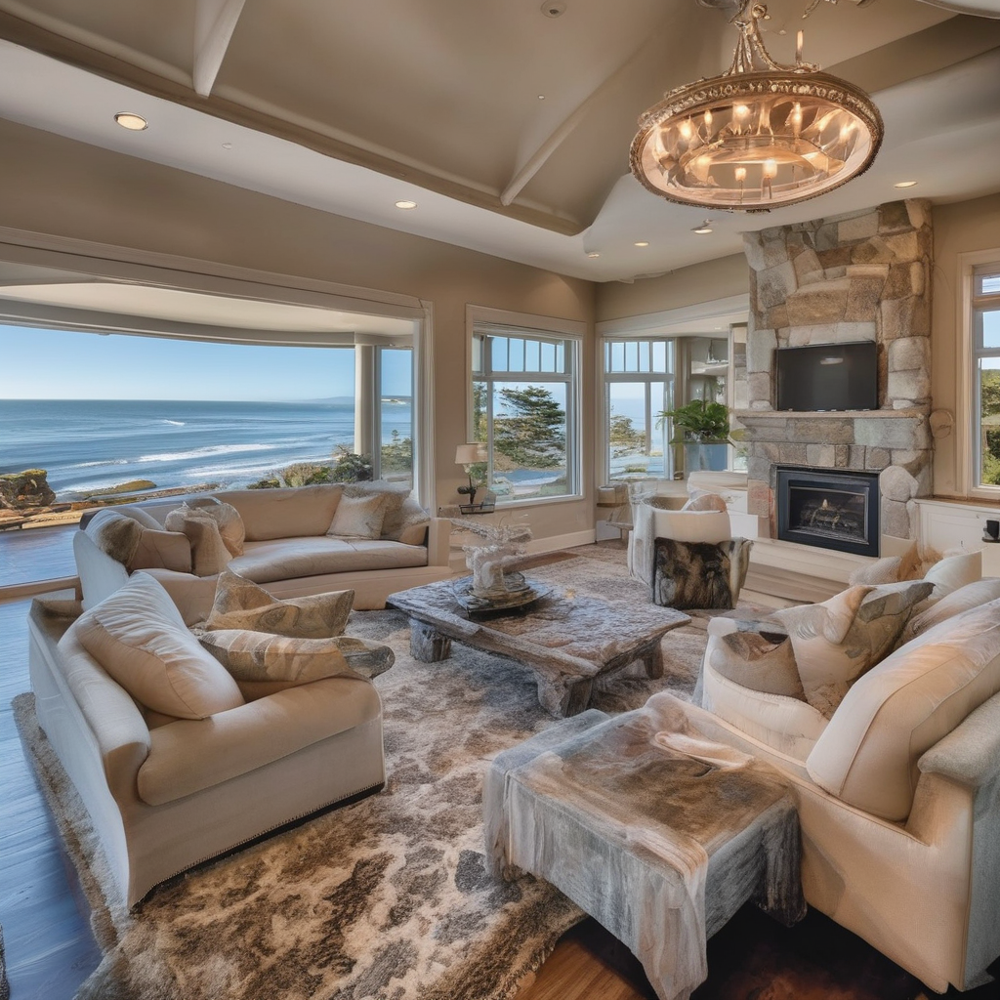

Processing... cozy_cottage.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

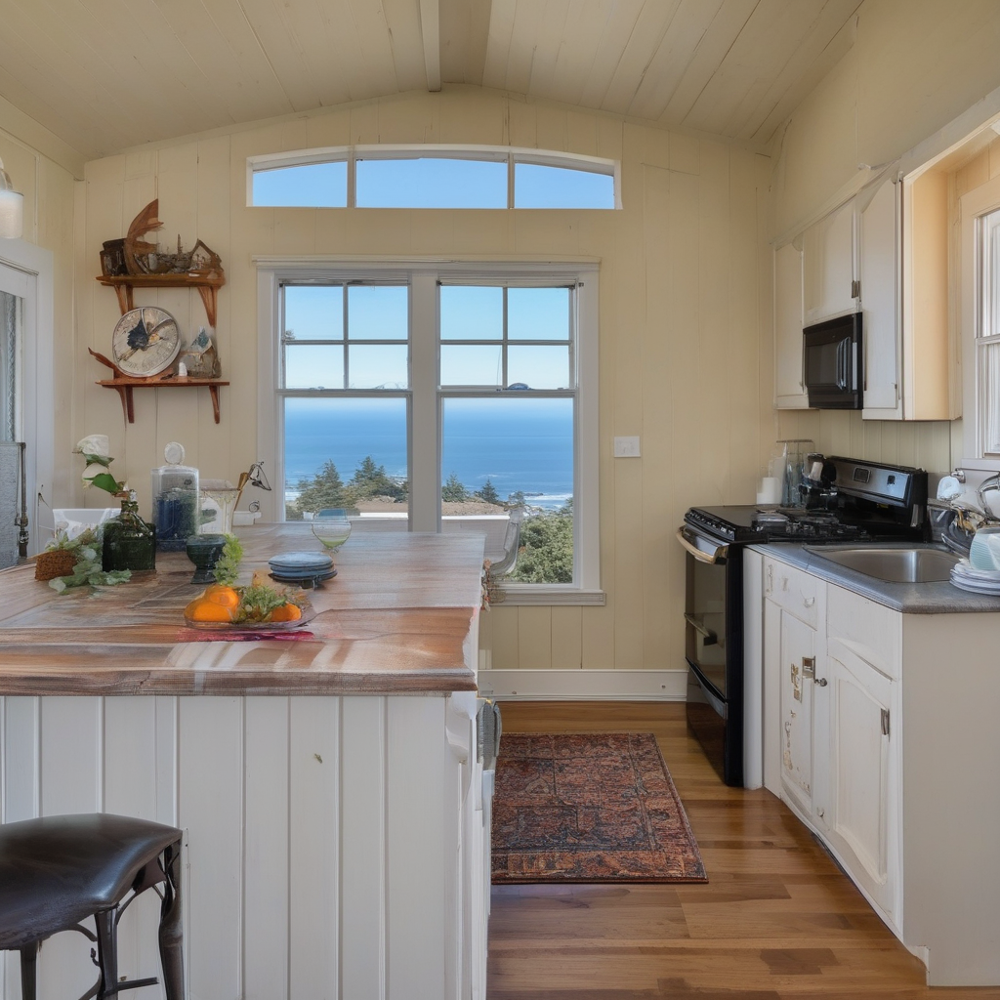

Processing... urban_loft.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

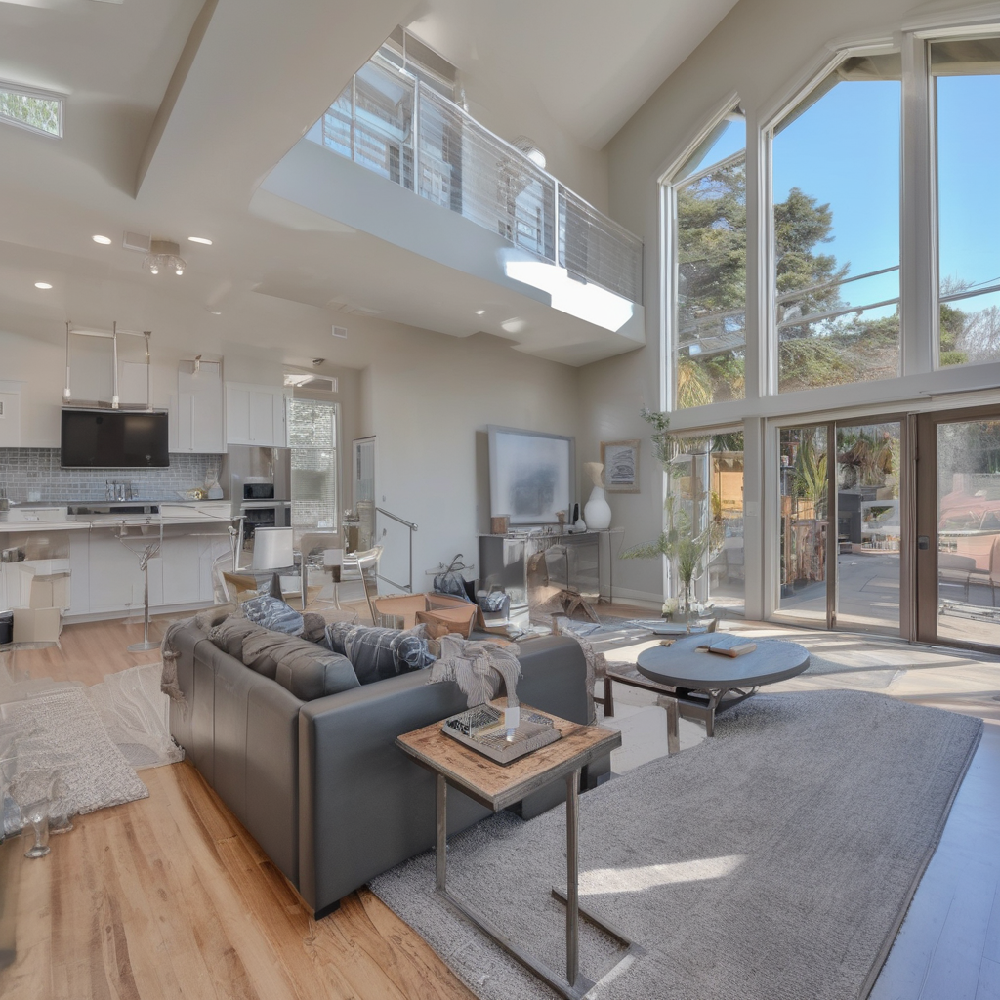

Processing... secluded_retreat.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

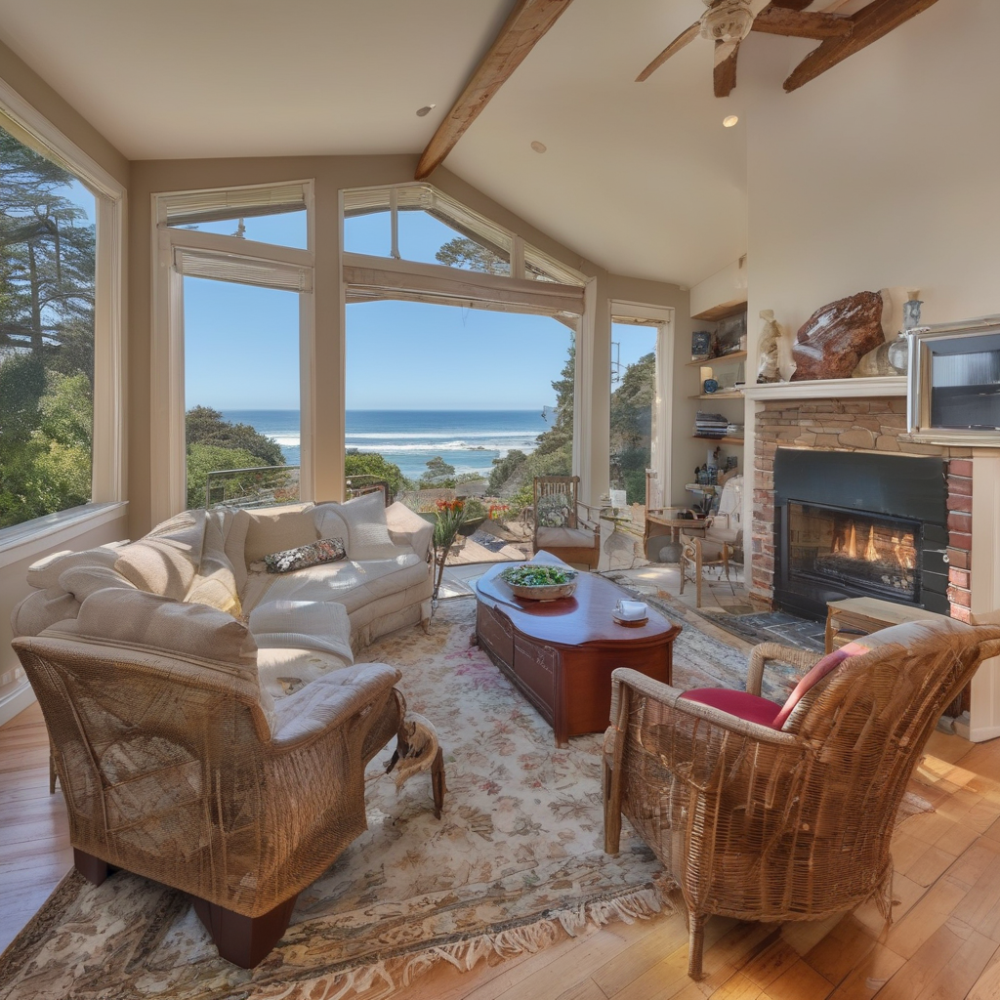

Processing... golf_paradise.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

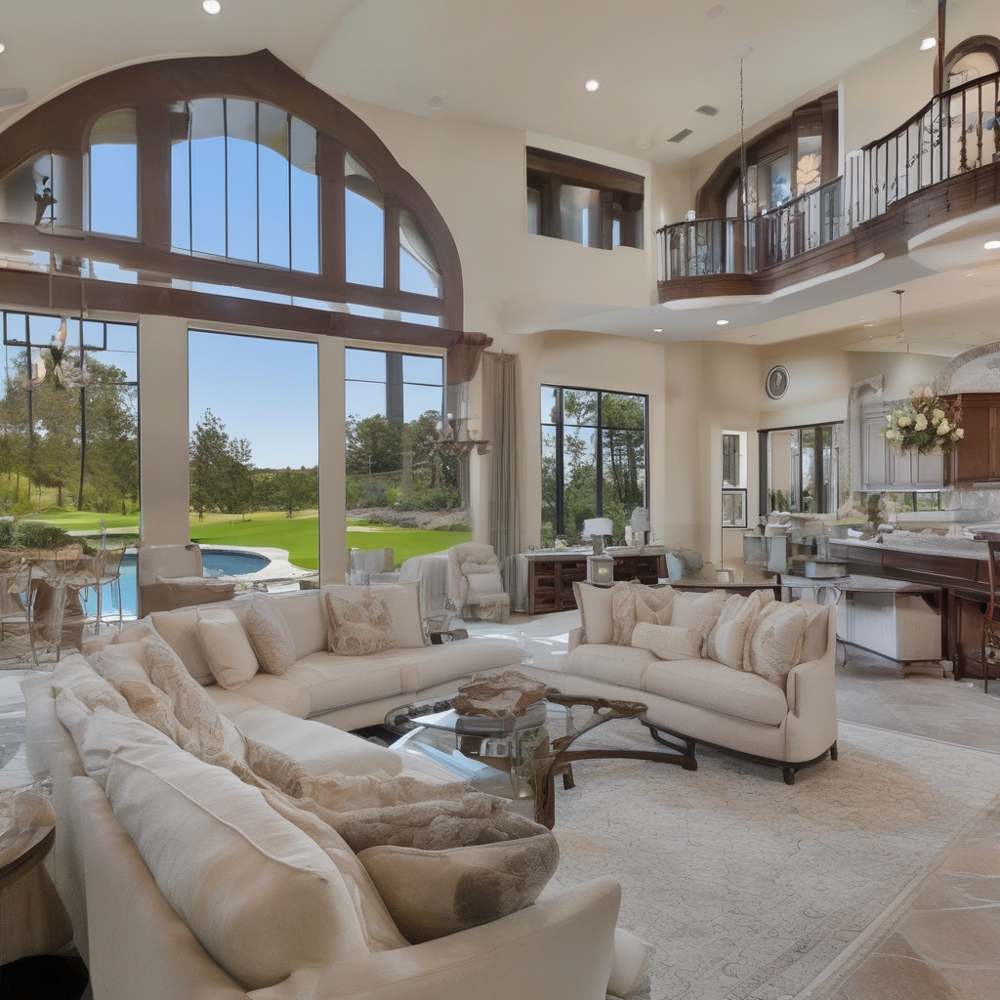

Processing... victorian_home.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

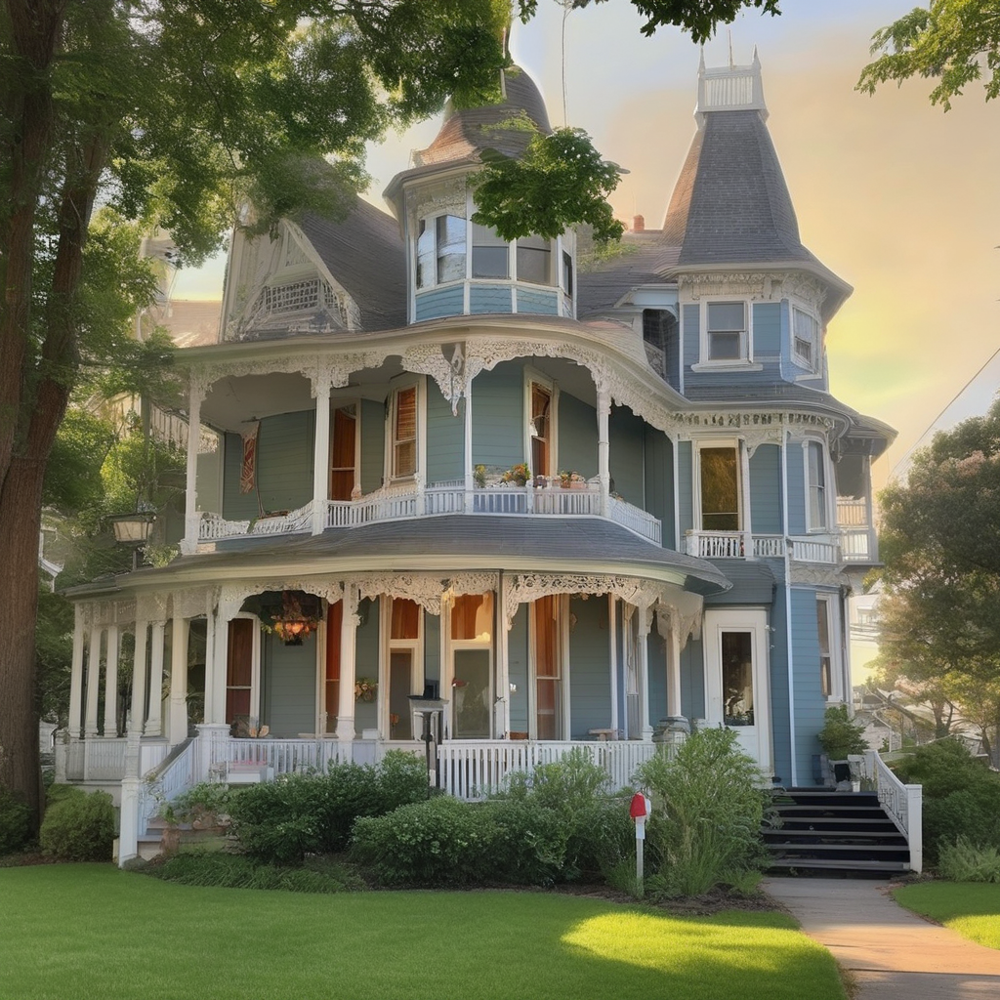

Processing... beachfront_villa.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

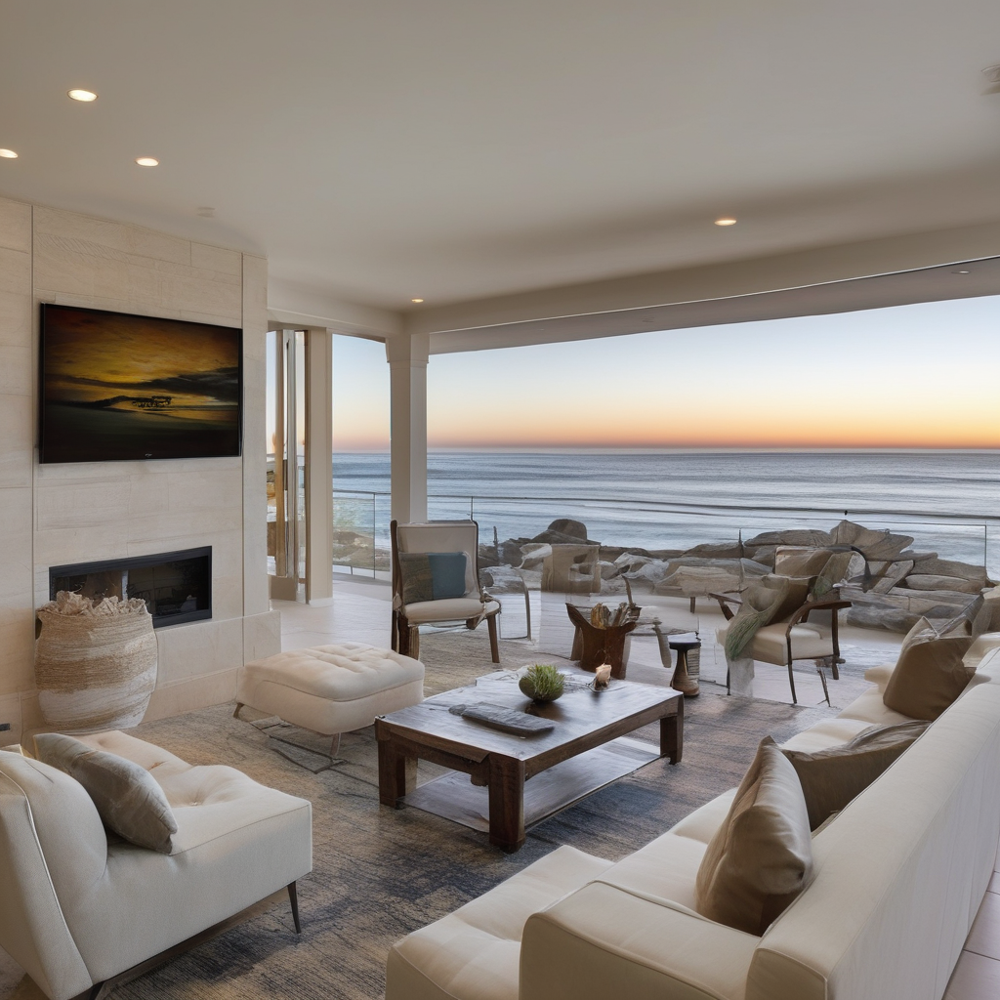

Processing... mediterranean_mansion.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

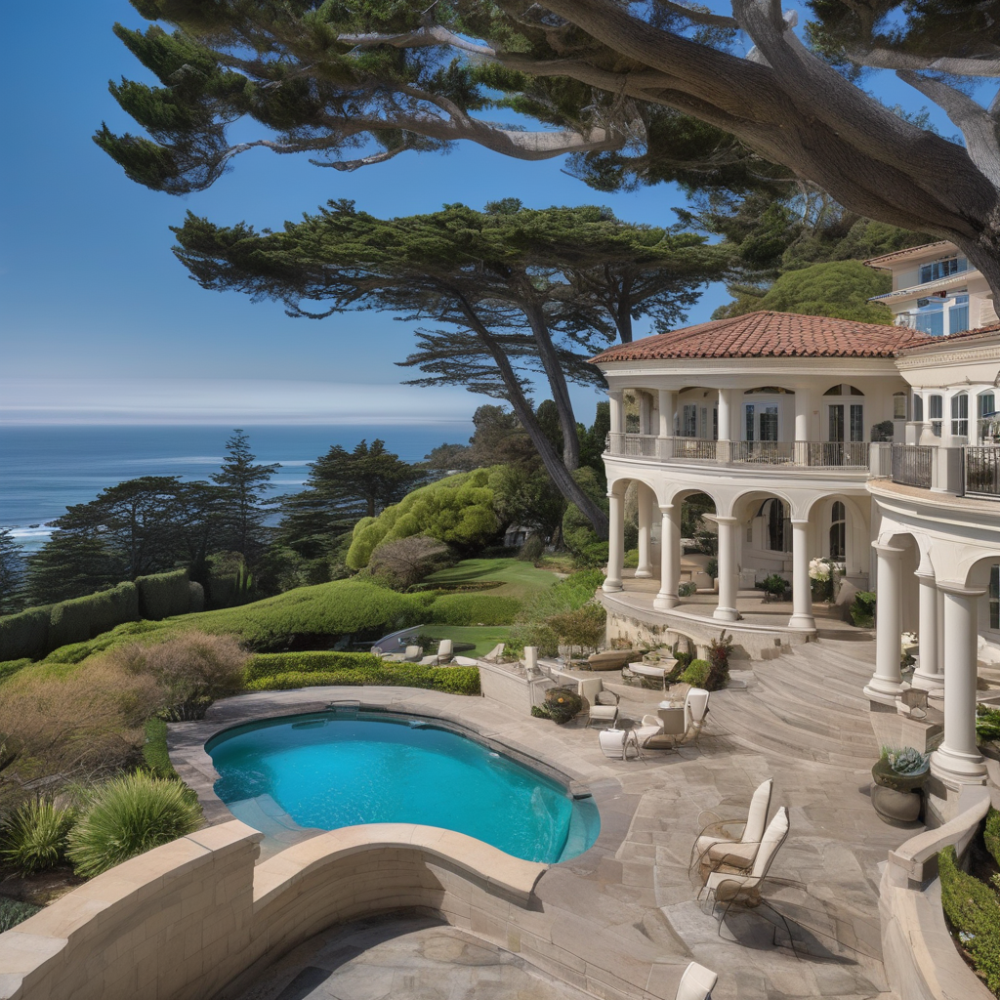

Processing... quaint_bungalow.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

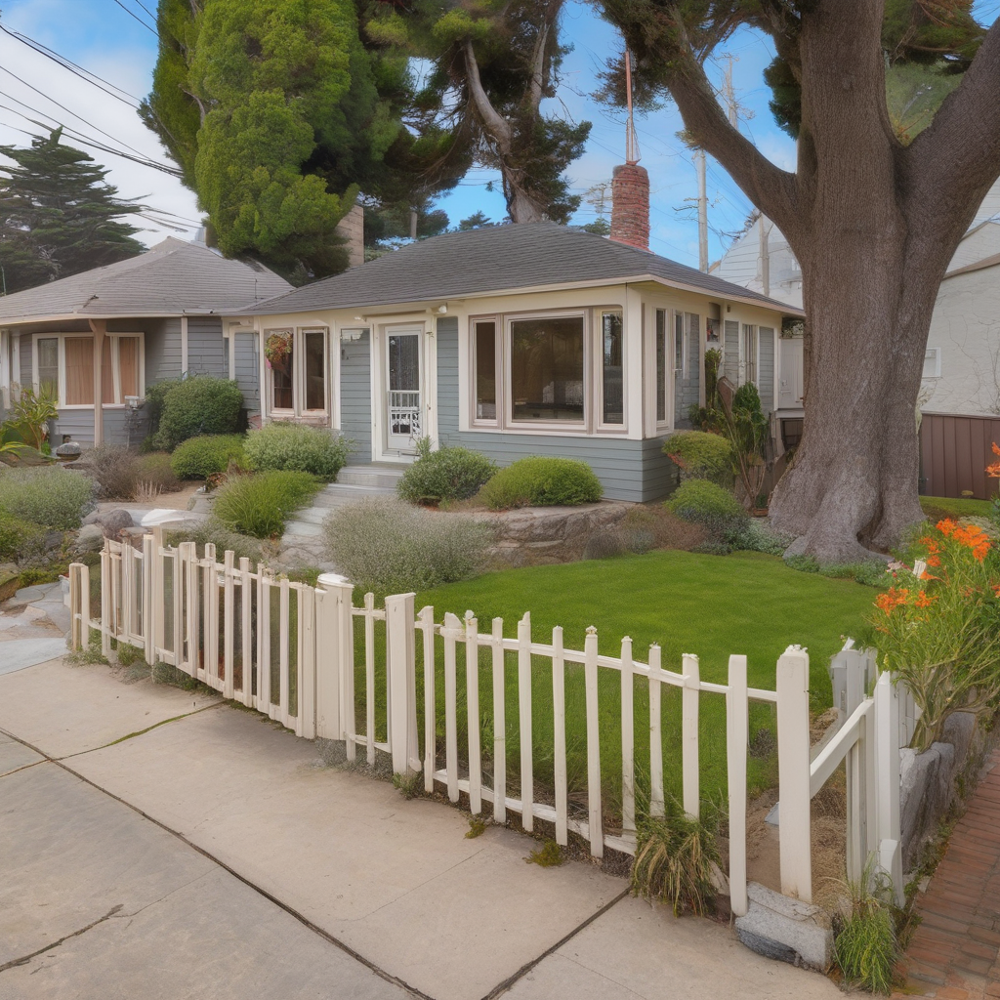

Processing... seaside_retreat.jpg


  0%|          | 0/50 [00:00<?, ?it/s]

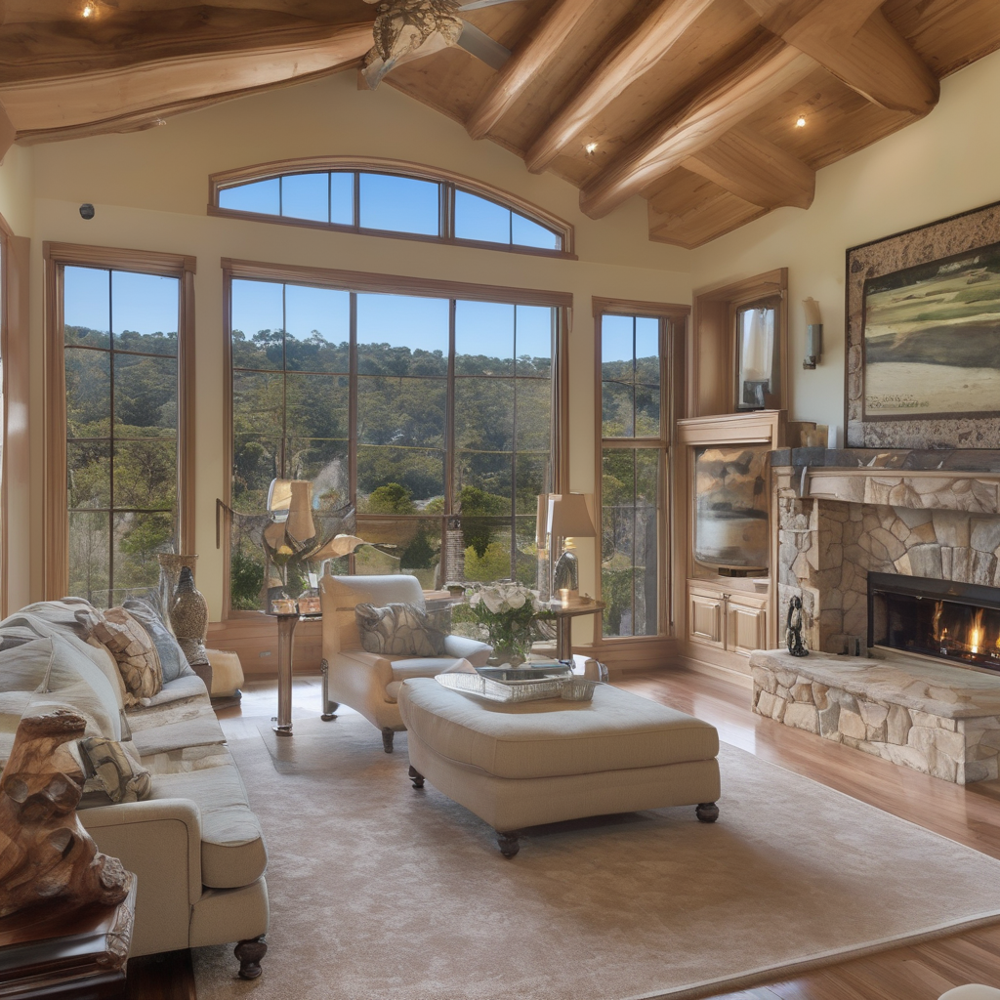

In [3]:
from PIL import Image  
import PIL  

# open listings.json file
f = open('listings.json')

# load data file and convert into json object.
#data = json.loads(json.load(f))
data=json.load(f)

for listing in data['listings']:
    filename = listing['filename']
    print("Processing...", filename)
    prompt = listing['description'] + listing['neighborhood']
    images = pipe(prompt=prompt).images[0]
    # show image
    images.show()
    # save image with given filename
    images = images.save(filename) 

# Closing file
f.close()